In [1]:
import warnings
warnings.simplefilter('ignore')
import numpy as np
np.warnings.filterwarnings('ignore')
np.random.seed(1001)

import os
import sys
import shutil
from pathlib import Path

import IPython
import matplotlib
import matplotlib.pyplot as plt
import pandas as pd
import seaborn as sns
from tqdm import tqdm_notebook
from sklearn.model_selection import StratifiedKFold

matplotlib.style.use('ggplot')
%matplotlib inline

DATAROOT = 'dataset'

datapath = Path(DATAROOT)

from keras.applications.vgg16 import VGG16

from keras.preprocessing import image
from keras.models import Model
from keras.layers import Dense, Flatten, Dropout
from keras import backend as K
import keras

from skimage.io import imread
from scipy.misc import imresize
from keras.preprocessing.image import ImageDataGenerator
from mixup_generator import MixupGenerator
from random_eraser import get_random_eraser
from sklearn.model_selection import train_test_split
from keras.utils import to_categorical
from keras.callbacks import (EarlyStopping, LearningRateScheduler,
                             ModelCheckpoint, TensorBoard, ReduceLROnPlateau)

### Model
def model_imagenet_x(input_shape, num_classes, weights='imagenet', show_layers=False):
    # create the base pre-trained model
    #base_model = InceptionV3(weights='imagenet', include_top=False, input_shape=input_shape)
    base_model = VGG16(weights=weights, include_top=False, input_shape=input_shape)

    # add a global spatial average pooling layer & FC
    x = base_model.output
    x = Flatten()(x)
    x = Dense(256, activation='relu')(x)

    if show_layers:
        for i, layer in enumerate(base_model.layers):
            print(i, layer.name)

    predictions = Dense(num_classes, activation='softmax')(x)

    # this is the model we will train
    model = Model(inputs=base_model.input, outputs=predictions)

    return model, base_model

### Configuration management class
class Config:
    def __init__(self,
                 learning_rate=0.0001,
                 batch_size=16,
                 shape=[224, 224, 3],
                 use_mixup=True,
                 use_augmentations=True,
                verbose=1):
        self.learning_rate = learning_rate
        self.batch_size = batch_size
        self.shape = shape
        self.verbose = verbose
        self.use_mixup = use_mixup
        self.use_augmentations = use_augmentations

### Dataset distribution utility
def get_class_distribution(y):
    # y_cls can be one of [OH label, index of class, class label name]
    # convert OH to index of class
    y_cls = [np.argmax(one) for one in y] if len(np.array(y).shape) == 2 else y
    # y_cls can be one of [index of class, class label name]
    classset = sorted(list(set(y_cls)))
    sample_distribution = {cur_cls:len([one for one in y_cls if one == cur_cls]) for cur_cls in classset}
    return sample_distribution

def get_class_distribution_list(y, num_classes):
    dist = get_class_distribution(y)
    assert(y[0].__class__ != str) # class index or class OH label only
    list_dist = np.zeros((num_classes))
    for i in range(num_classes):
        if i in dist:
            list_dist[i] = dist[i]
    return list_dist

from imblearn.over_sampling import RandomOverSampler
def balance_class_by_over_sampling(X, y): # Naive: all sample has equal weights
    Xidx = [[xidx] for xidx in range(len(X))]
    y_cls = [np.argmax(one) for one in y]
    classset = sorted(list(set(y_cls)))
    sample_distribution = [len([one for one in y_cls if one == cur_cls]) for cur_cls in classset]
    nsamples = np.max(sample_distribution)
    flat_ratio = {cls:nsamples for cls in classset}
    Xidx_resampled, y_cls_resampled = RandomOverSampler(ratio=flat_ratio, random_state=42).fit_sample(Xidx, y_cls)
    sampled_index = [idx[0] for idx in Xidx_resampled]
    return np.array([X[idx] for idx in sampled_index]), np.array([y[idx] for idx in sampled_index])

### Dataset management class
class LabeledDataset:
    image_suffix = ['.jpg', '.JPG']
    def __init__(self, datapath, shape, batch_size):
        self.datapath = Path(datapath)
        self.shape = shape
        self.batch_size = batch_size
    def load_image(filename, shape, rescale_factor):
        img = imread(filename)
        return imresize(img, shape[:2]) * rescale_factor
    def load_as_image(self):
        # datapath shall contain label/file labeled data files
        train_files = sorted([x for x in self.datapath.glob('*/*') if x.suffix in LabeledDataset.image_suffix])
        self.X_train = np.array([LabeledDataset.load_image(filename, self.shape, rescale_factor=1/255.)
                                    for filename in train_files])
        y_train_label = [filename.parent.name for filename in train_files]
        self.labels = sorted(list(set(y_train_label)))
        self.label2int = {label:i for i, label in enumerate(self.labels)}
        self.y_train = to_categorical([self.label2int[label] for label in y_train_label])
    def split_train_valid(self, test_size=0.2, random_state=42):
        self.cur_X_train, self.cur_X_valid, self.cur_y_train, self.cur_y_valid = train_test_split(
            self.X_train, 
            self.y_train, 
            test_size=test_size,
            random_state=random_state)
        self.cur_X_train, self.cur_y_train = \
            balance_class_by_over_sampling(self.cur_X_train, self.cur_y_train)
    def load_test_as_image(self, test_datapath):
        test_datapath = Path(test_datapath)
        test_files = sorted([x for x in test_datapath.glob('*') if x.suffix in LabeledDataset.image_suffix])
        self.X_test = np.array([LabeledDataset.load_image(filename, self.shape, rescale_factor=1/255.)
                                for filename in test_files])
    def create_test_generator(self, IDG_options={}):
        test_datagen = ImageDataGenerator(**IDG_options)
        y_test_dummy = to_categorical([0 for _ in range(len(self.X_test))])
        self.test_gen = test_datagen.flow(self.X_test, y_test_dummy,
                                          batch_size=len(self.X_test), shuffle=False) ########## self.batch_size
    def create_generator(self, conf, IDG_options={}):
        aug_datagen = ImageDataGenerator(**IDG_options)
        if conf.use_mixup:
            self.train_gen = MixupGenerator(self.cur_X_train, self.cur_y_train, 
                                            alpha=1.0, batch_size=self.batch_size,
                                            datagen=aug_datagen)()
        else:
            self.train_gen = aug_datagen.flow(self.cur_X_train, self.cur_y_train, 
                                              batch_size=self.batch_size)
        plain_datagen = ImageDataGenerator()
        self.valid_gen = plain_datagen.flow(self.cur_X_valid, self.cur_y_valid,
                                                              batch_size=self.batch_size, shuffle=False)
    def train_steps_per_epoch(self):
        return len(self.cur_X_train) // self.batch_size
    def valid_steps_per_epoch(self):
        return len(self.cur_X_valid) // self.batch_size

def reset_generator():
    if conf.use_augmentations:
        IDG_options={'horizontal_flip': True, 'vertical_flip': True,
                     'rotation_range': 40, 'zoom_range': 0.3,
                      'preprocessing_function': get_random_eraser(v_l=np.min(d.X_train),                                                           
                                                    v_h=np.max(d.X_train))}
    else:
        IDG_options={}
    d.create_generator(conf, IDG_options)

Using TensorFlow backend.


In [2]:
conf = Config(batch_size=8, shape=[224, 224, 3], 
              use_mixup=True, use_augmentations=True)

d = LabeledDataset(datapath / 'train', conf.shape, conf.batch_size)
d.load_as_image()
d.split_train_valid()

## From Scratch, By Using Mixup & Augmentation

In [3]:
%%time
model, base_model = model_imagenet_x(input_shape=conf.shape, 
                                     num_classes=len(d.labels), weights=None)
model.compile(loss='categorical_crossentropy',
              optimizer=keras.optimizers.Adam(lr=conf.learning_rate),
              metrics=['accuracy'])
callbacks = [
    ModelCheckpoint('model_weights_from_scratch_full_aug.h5', 
                    monitor='val_loss', verbose=1, save_best_only=True),
]
reset_generator()
model.fit_generator(d.train_gen, 
          steps_per_epoch=d.train_steps_per_epoch(),
          epochs=150,
          validation_data=d.valid_gen,
          validation_steps=d.valid_steps_per_epoch(),
          callbacks=callbacks,
          verbose=conf.verbose)

Epoch 1/150
15/15 [==============================] - 6s 374ms/step - loss: 1.7923 - acc: 0.1083 - val_loss: 1.7897 - val_acc: 0.1250

Epoch 00001: val_loss improved from inf to 1.78972, saving model to model_weights_from_scratch_full_aug.h5
Epoch 2/150
15/15 [==============================] - 2s 128ms/step - loss: 1.7920 - acc: 0.1417 - val_loss: 1.7914 - val_acc: 0.2500

Epoch 00002: val_loss did not improve from 1.78972
Epoch 3/150
15/15 [==============================] - 2s 128ms/step - loss: 1.7654 - acc: 0.2417 - val_loss: 1.7618 - val_acc: 0.1250

Epoch 00003: val_loss improved from 1.78972 to 1.76184, saving model to model_weights_from_scratch_full_aug.h5
Epoch 4/150
15/15 [==============================] - 2s 128ms/step - loss: 1.6439 - acc: 0.3583 - val_loss: 1.7087 - val_acc: 0.1250

Epoch 00004: val_loss improved from 1.76184 to 1.70873, saving model to model_weights_from_scratch_full_aug.h5
Epoch 5/150
15/15 [==============================] - 2s 128ms/step - loss: 1.6684 - 


Epoch 00040: val_loss did not improve from 0.66513
Epoch 41/150
15/15 [==============================] - 2s 128ms/step - loss: 0.9381 - acc: 0.8250 - val_loss: 0.6591 - val_acc: 0.8750

Epoch 00041: val_loss improved from 0.66513 to 0.65913, saving model to model_weights_from_scratch_full_aug.h5
Epoch 42/150
15/15 [==============================] - 2s 127ms/step - loss: 1.0184 - acc: 0.6333 - val_loss: 0.9140 - val_acc: 0.5000

Epoch 00042: val_loss did not improve from 0.65913
Epoch 43/150
15/15 [==============================] - 2s 129ms/step - loss: 1.0433 - acc: 0.8000 - val_loss: 0.8446 - val_acc: 0.8750

Epoch 00043: val_loss did not improve from 0.65913
Epoch 44/150
15/15 [==============================] - 2s 128ms/step - loss: 0.9954 - acc: 0.7167 - val_loss: 0.9751 - val_acc: 0.3750

Epoch 00044: val_loss did not improve from 0.65913
Epoch 45/150
15/15 [==============================] - 2s 128ms/step - loss: 1.0662 - acc: 0.7667 - val_loss: 0.6265 - val_acc: 0.8750

Epoch 000


Epoch 00081: val_loss did not improve from 0.14799
Epoch 82/150
15/15 [==============================] - 2s 129ms/step - loss: 0.6727 - acc: 0.8833 - val_loss: 0.2057 - val_acc: 1.0000

Epoch 00082: val_loss did not improve from 0.14799
Epoch 83/150
15/15 [==============================] - 2s 129ms/step - loss: 0.7400 - acc: 0.8500 - val_loss: 0.2216 - val_acc: 1.0000

Epoch 00083: val_loss did not improve from 0.14799
Epoch 84/150
15/15 [==============================] - 2s 129ms/step - loss: 0.6637 - acc: 0.9167 - val_loss: 0.2320 - val_acc: 1.0000

Epoch 00084: val_loss did not improve from 0.14799
Epoch 85/150
15/15 [==============================] - 2s 131ms/step - loss: 0.6986 - acc: 0.9333 - val_loss: 0.2265 - val_acc: 1.0000

Epoch 00085: val_loss did not improve from 0.14799
Epoch 86/150
15/15 [==============================] - 2s 128ms/step - loss: 0.6824 - acc: 0.9000 - val_loss: 0.1340 - val_acc: 1.0000

Epoch 00086: val_loss improved from 0.14799 to 0.13397, saving model 

Epoch 125/150
15/15 [==============================] - 2s 129ms/step - loss: 0.6642 - acc: 0.9250 - val_loss: 0.0764 - val_acc: 1.0000

Epoch 00125: val_loss improved from 0.08435 to 0.07641, saving model to model_weights_from_scratch_full_aug.h5
Epoch 126/150
15/15 [==============================] - 2s 128ms/step - loss: 0.6627 - acc: 0.8833 - val_loss: 0.1589 - val_acc: 1.0000

Epoch 00126: val_loss did not improve from 0.07641
Epoch 127/150
15/15 [==============================] - 2s 128ms/step - loss: 0.7387 - acc: 0.9167 - val_loss: 0.2012 - val_acc: 1.0000

Epoch 00127: val_loss did not improve from 0.07641
Epoch 128/150
15/15 [==============================] - 2s 129ms/step - loss: 0.6555 - acc: 0.8917 - val_loss: 0.1489 - val_acc: 1.0000

Epoch 00128: val_loss did not improve from 0.07641
Epoch 129/150
15/15 [==============================] - 2s 129ms/step - loss: 0.7100 - acc: 0.8250 - val_loss: 0.2204 - val_acc: 1.0000

Epoch 00129: val_loss did not improve from 0.07641
Epoch

## From Scratch By Using Augmentation Only, But No Mixup

In [4]:
%%time
conf = Config(batch_size=8, shape=[224, 224, 3], 
              use_mixup=False, use_augmentations=True)
model, base_model = model_imagenet_x(input_shape=conf.shape, 
                                     num_classes=len(d.labels), weights=None)
model.compile(loss='categorical_crossentropy',
              optimizer=keras.optimizers.Adam(lr=conf.learning_rate),
              metrics=['accuracy'])
callbacks = [
    ModelCheckpoint('model_weights_from_scratch_aug_no_mixup.h5', 
                    monitor='val_loss', verbose=1, save_best_only=True),
]
reset_generator()
model.fit_generator(d.train_gen, 
          steps_per_epoch=d.train_steps_per_epoch(),
          epochs=150,
          validation_data=d.valid_gen,
          validation_steps=d.valid_steps_per_epoch(),
          callbacks=callbacks,
          verbose=conf.verbose)

Epoch 1/150
15/15 [==============================] - 4s 255ms/step - loss: 1.7937 - acc: 0.1137 - val_loss: 1.7912 - val_acc: 0.1250

Epoch 00001: val_loss improved from inf to 1.79125, saving model to model_weights_from_scratch_aug_no_mixup.h5
Epoch 2/150
15/15 [==============================] - 2s 129ms/step - loss: 1.7919 - acc: 0.1833 - val_loss: 1.7917 - val_acc: 0.1250

Epoch 00002: val_loss did not improve from 1.79125
Epoch 3/150
15/15 [==============================] - 2s 128ms/step - loss: 1.7877 - acc: 0.1722 - val_loss: 1.7259 - val_acc: 0.1250

Epoch 00003: val_loss improved from 1.79125 to 1.72587, saving model to model_weights_from_scratch_aug_no_mixup.h5
Epoch 4/150
15/15 [==============================] - 2s 126ms/step - loss: 1.6603 - acc: 0.2471 - val_loss: 1.6682 - val_acc: 0.3750

Epoch 00004: val_loss improved from 1.72587 to 1.66822, saving model to model_weights_from_scratch_aug_no_mixup.h5
Epoch 5/150
15/15 [==============================] - 2s 124ms/step - los

Epoch 41/150
15/15 [==============================] - 2s 125ms/step - loss: 0.6047 - acc: 0.7302 - val_loss: 0.4757 - val_acc: 0.8750

Epoch 00041: val_loss did not improve from 0.27124
Epoch 42/150
15/15 [==============================] - 2s 124ms/step - loss: 0.4699 - acc: 0.7304 - val_loss: 0.8023 - val_acc: 0.8750

Epoch 00042: val_loss did not improve from 0.27124
Epoch 43/150
15/15 [==============================] - 2s 125ms/step - loss: 0.5549 - acc: 0.7833 - val_loss: 0.4937 - val_acc: 0.8750

Epoch 00043: val_loss did not improve from 0.27124
Epoch 44/150
15/15 [==============================] - 2s 122ms/step - loss: 0.4294 - acc: 0.8137 - val_loss: 0.4396 - val_acc: 0.8750

Epoch 00044: val_loss did not improve from 0.27124
Epoch 45/150
15/15 [==============================] - 2s 130ms/step - loss: 0.5550 - acc: 0.7000 - val_loss: 0.5454 - val_acc: 0.8750

Epoch 00045: val_loss did not improve from 0.27124
Epoch 46/150
15/15 [==============================] - 2s 123ms/step - 


Epoch 00083: val_loss improved from 0.08031 to 0.05826, saving model to model_weights_from_scratch_aug_no_mixup.h5
Epoch 84/150
15/15 [==============================] - 2s 125ms/step - loss: 0.3069 - acc: 0.8888 - val_loss: 1.0819 - val_acc: 0.7500

Epoch 00084: val_loss did not improve from 0.05826
Epoch 85/150
15/15 [==============================] - 2s 126ms/step - loss: 0.3829 - acc: 0.8583 - val_loss: 0.9262 - val_acc: 0.7500

Epoch 00085: val_loss did not improve from 0.05826
Epoch 86/150
15/15 [==============================] - 2s 123ms/step - loss: 0.2223 - acc: 0.9306 - val_loss: 0.4879 - val_acc: 0.8750

Epoch 00086: val_loss did not improve from 0.05826
Epoch 87/150
15/15 [==============================] - 2s 125ms/step - loss: 0.2234 - acc: 0.9499 - val_loss: 0.1045 - val_acc: 1.0000

Epoch 00087: val_loss did not improve from 0.05826
Epoch 88/150
15/15 [==============================] - 2s 128ms/step - loss: 0.0559 - acc: 0.9917 - val_loss: 0.0566 - val_acc: 1.0000

Epoch

15/15 [==============================] - 2s 124ms/step - loss: 0.0995 - acc: 0.9750 - val_loss: 0.9425 - val_acc: 0.8750

Epoch 00126: val_loss did not improve from 0.04414
Epoch 127/150
15/15 [==============================] - 2s 124ms/step - loss: 0.1461 - acc: 0.9416 - val_loss: 1.3497 - val_acc: 0.8750

Epoch 00127: val_loss did not improve from 0.04414
Epoch 128/150
15/15 [==============================] - 2s 126ms/step - loss: 0.3407 - acc: 0.9166 - val_loss: 0.3329 - val_acc: 0.8750

Epoch 00128: val_loss did not improve from 0.04414
Epoch 129/150
15/15 [==============================] - 2s 126ms/step - loss: 0.5504 - acc: 0.8723 - val_loss: 0.5684 - val_acc: 0.7500

Epoch 00129: val_loss did not improve from 0.04414
Epoch 130/150
15/15 [==============================] - 2s 128ms/step - loss: 0.2953 - acc: 0.9082 - val_loss: 0.8901 - val_acc: 0.6250

Epoch 00130: val_loss did not improve from 0.04414
Epoch 131/150
15/15 [==============================] - 2s 125ms/step - loss: 0.

# Evaluation

In [4]:
test_expected_preds = np.array([
    [0, 1, 0, 0, 0, 0],
    [0, 0, 0, 0, 1, 0],
    [0, 0, 0, 0, 1, 0],
    [0, 0, 0, 0, 1, 0],
    [0, 0, 0, 0, 0, 1],
    [0, 0, 0, 0, 0, 1],
])
test_difficult_expected_preds = np.array([
    [0, 0.2, 0.2, 0.2, 0.2, 0.2],
    [0, 0.2, 0.2, 0.2, 0.2, 0.2],
    [0, 0.2, 0.2, 0.2, 0.2, 0.2],
    [0, 0.1, 0.0, 0.4, 0.4, 0.1],
    [0, 0.7, 0.0, 0.2, 0.1, 0.1],
    [0, 0.1, 0.0, 0.1, 0.1, 0.7], # 5495
    [0.8, 0, 0, 0, 0, 0.2],
    [0, 0, 1, 0, 0, 0],
    [0, 0, 1, 0, 0, 0],
    [0, 0.1, 0, 0, 0, 0.9],
    [0, 0.3, 0, 0.2, 0.2, 0.4], # 5500
    [0, 0.1, 0, 0.1, 0.7, 0.1],
    [0, 0.1, 0, 0.8, 0.1, 0],
    [0, 0.0, 0, 0.8, 0.2, 0],
    [0, 0, 1, 0, 0, 0],
    [0, 0.8, 0.2, 0, 0, 0], # 5506
    [0, 0.6, 0, 0.4, 0, 0],
    [0, 0.2, 0, 0.6, 0.2, 0],
    [0, 0, 0, 0.2, 0.7, 0.1],
    [0, 0, 0, 0, 0.4, 0.6]
])

def calc_soft_acc(expected, pred):
    pred_idx = np.argmax(pred)
    return 1 if expected[pred_idx] >= 0.2 else 0

def evaluate_test(model, model_weight, test_datapath, expected_preds, test_time_aug_param, 
                  show_detail=True):
    d.load_test_as_image(test_datapath)
    d.create_test_generator(test_time_aug_param)
    model.load_weights(model_weight)
    cur_X_test, cur_y_test = next(d.test_gen)
    preds = model.predict(cur_X_test)
    results = np.argmax(preds, axis=1)
    references = np.argmax(expected_preds, axis=-1)
    #accuracy = np.sum(results == references) / len(preds)
    accuracy = np.sum([calc_soft_acc(expected, pred)
                        for expected, pred in zip(expected_preds, preds)])\
                       / len(preds)
    print('accuracy = ', accuracy)
    #score_all = np.sum(preds * expected_preds) / len(preds)
    #print('prediction score =', score_all)
    if show_detail:
        for no, (img, result, ref, pred) in enumerate(zip(cur_X_test, results, references, preds)):
            plt.imshow(img)
            plt.axis('off')
            plt.title('#%d %s? %s %s' % (no, d.labels[result], 'yes' if result == ref else 'no',
                                         str({d.labels[i]:pred[i] for i in range(len(pred))})))
            plt.show()
    return accuracy

accuracy =  1.0


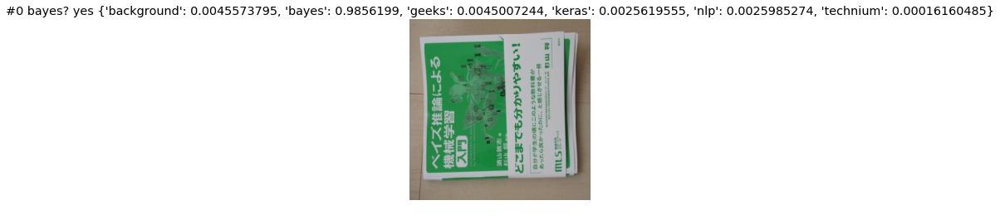

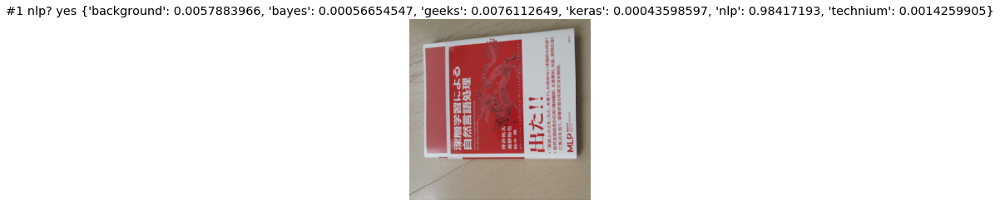

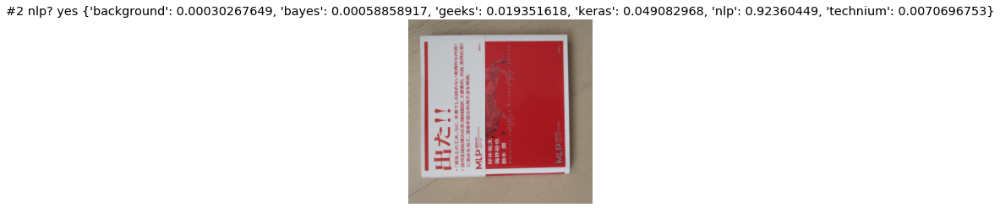

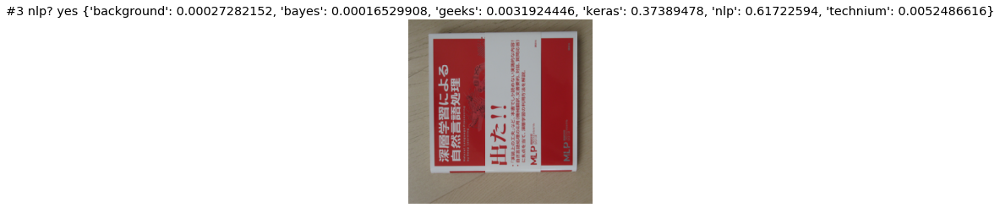

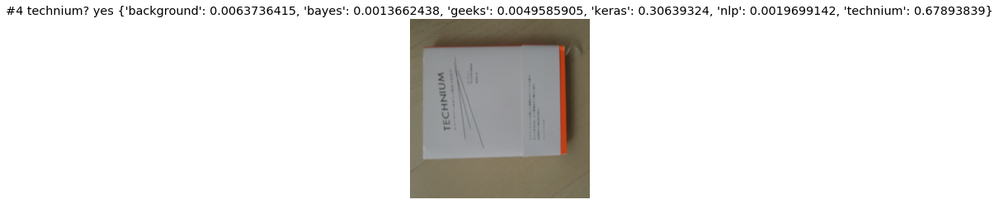

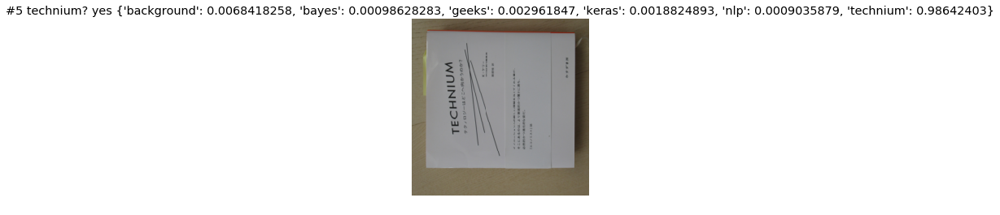

1.0

In [6]:
evaluate_test(model, 'model_weights_from_scratch_full_aug.h5', datapath / 'test', test_expected_preds, {})

accuracy =  0.833333333333


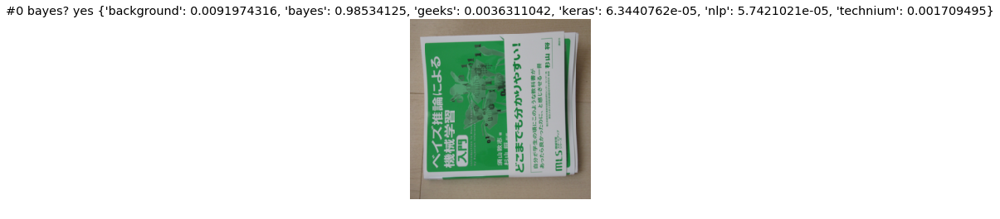

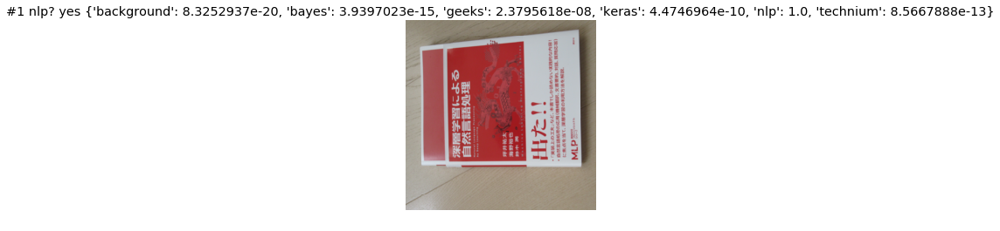

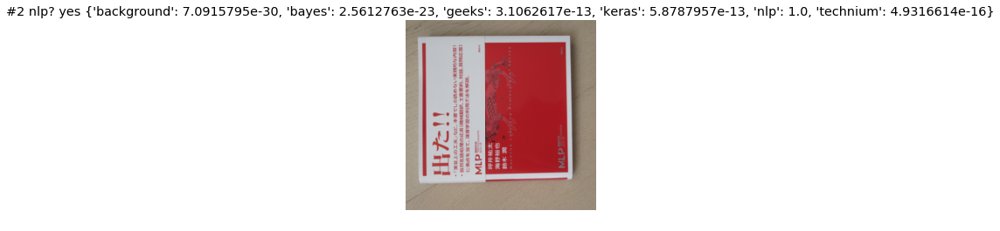

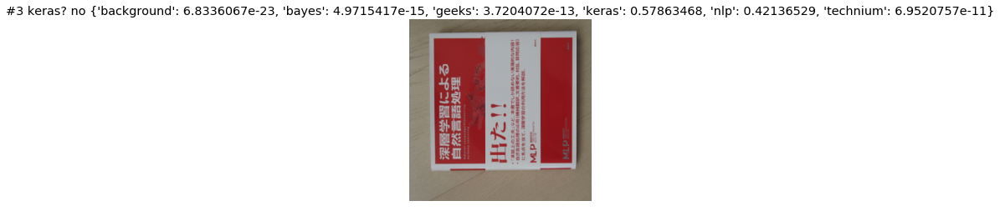

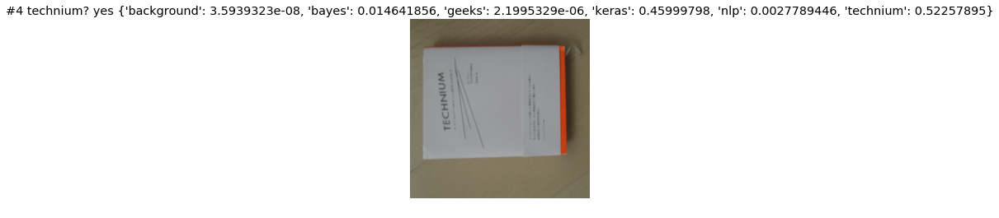

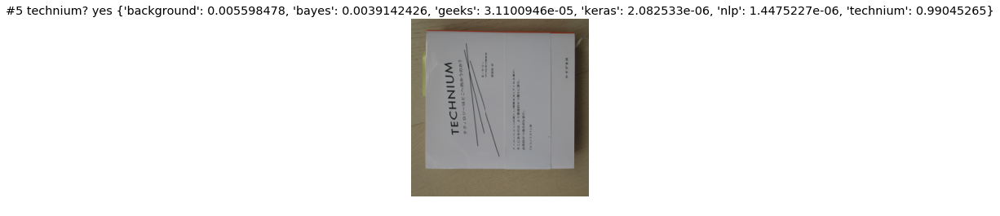

0.83333333333333337

In [7]:
evaluate_test(model, 'model_weights_from_scratch_aug_no_mixup.h5', datapath / 'test', test_expected_preds, {})

In [8]:
evaluate_test(model, 'model_weights_from_scratch_full_aug.h5', datapath / 'test_difficult',
              test_difficult_expected_preds, {}, show_detail=False)
evaluate_test(model, 'model_weights_from_scratch_aug_no_mixup.h5', datapath / 'test_difficult',
              test_difficult_expected_preds, {}, show_detail=False)

accuracy =  0.65
accuracy =  0.6


0.59999999999999998

# ImageNet Based

In [9]:
def imagenet_based_evaluation(train_points, model_footer, epochs):
    hists, accuracies = [], []
    for train_point in train_points:
        weight_filename = 'model_weights_%s_imagenet_%s.h5' % (train_point, model_footer)
        callbacks = [
            ModelCheckpoint(weight_filename, monitor='val_loss', verbose=2, save_best_only=True, save_weights_only=True),
            #TensorBoard(log_dir=d.file_with_prefix('logs%s/fold_%d' % (conf.prefix, i)), write_graph=True)
        ]
        reset_generator()

        print('[%s]' % train_point)
        model, base_model = model_imagenet_x(input_shape=conf.shape, num_classes=len(d.labels), weights='imagenet')
        for layer in base_model.layers:
            layer.trainable = False
        model.compile(loss='categorical_crossentropy',
                      optimizer=keras.optimizers.Adam(lr=conf.learning_rate),
                      metrics=['accuracy'])
        model.fit_generator(d.train_gen, 
                  steps_per_epoch=d.train_steps_per_epoch(),
                  epochs=30,
                  validation_data=d.valid_gen,
                  validation_steps=d.valid_steps_per_epoch(),
                  callbacks=callbacks,
                  verbose=conf.verbose)
        print('\n----------------------------------------------')
        print('Roughly trained, now fine tune from', train_point, 'for', epochs, 'epochs.')
        trainable = False
        for layer in base_model.layers:
            if layer.name == train_point:
                trainable = True
            layer.trainable = trainable
        model.load_weights(weight_filename)
        model.compile(loss='categorical_crossentropy',
                      optimizer=keras.optimizers.RMSprop(lr=conf.learning_rate*0.1),
                      metrics=['accuracy'])
        history = model.fit_generator(d.train_gen, 
                  steps_per_epoch=d.train_steps_per_epoch(),
                  epochs=epochs,
                  validation_data=d.valid_gen,
                  validation_steps=d.valid_steps_per_epoch(),
                  callbacks=callbacks,
                  verbose=conf.verbose)

        acc = evaluate_test(model, weight_filename, datapath / 'test_difficult', test_difficult_expected_preds, {}, show_detail=False)
        hists.append(history)
        accuracies.append(acc)
        K.clear_session()
    print()
    return hists, accuracies

## Imagenet Based By Using Mixup & Augmentation

In [10]:
%%time
conf = Config(batch_size=8, shape=[224, 224, 3], 
              use_mixup=True, use_augmentations=True)
imagenet_based_evaluation(train_points=['block4_conv1'], model_footer='full_aug', epochs=50)

[block4_conv1]
Epoch 1/30
15/15 [==============================] - 1s 91ms/step - loss: 1.9756 - acc: 0.3083 - val_loss: 0.8710 - val_acc: 0.7500

Epoch 00001: val_loss improved from inf to 0.87096, saving model to model_weights_block4_conv1_imagenet_full_aug.h5
Epoch 2/30
15/15 [==============================] - 1s 57ms/step - loss: 1.4215 - acc: 0.5750 - val_loss: 0.5688 - val_acc: 0.8750

Epoch 00002: val_loss improved from 0.87096 to 0.56880, saving model to model_weights_block4_conv1_imagenet_full_aug.h5
Epoch 3/30
15/15 [==============================] - 1s 78ms/step - loss: 1.2727 - acc: 0.6667 - val_loss: 0.4727 - val_acc: 0.7500

Epoch 00003: val_loss improved from 0.56880 to 0.47271, saving model to model_weights_block4_conv1_imagenet_full_aug.h5
Epoch 4/30
15/15 [==============================] - 1s 80ms/step - loss: 1.1405 - acc: 0.7833 - val_loss: 0.3665 - val_acc: 0.8750

Epoch 00004: val_loss improved from 0.47271 to 0.36651, saving model to model_weights_block4_conv1_im

Epoch 11/50
15/15 [==============================] - 1s 81ms/step - loss: 0.7412 - acc: 0.8833 - val_loss: 0.1375 - val_acc: 1.0000

Epoch 00011: val_loss did not improve from 0.09391
Epoch 12/50
15/15 [==============================] - 1s 80ms/step - loss: 0.7717 - acc: 0.9333 - val_loss: 0.0953 - val_acc: 1.0000

Epoch 00012: val_loss did not improve from 0.09391
Epoch 13/50
15/15 [==============================] - 1s 80ms/step - loss: 0.8537 - acc: 0.8667 - val_loss: 0.1047 - val_acc: 1.0000

Epoch 00013: val_loss did not improve from 0.09391
Epoch 14/50
15/15 [==============================] - 1s 80ms/step - loss: 0.8178 - acc: 0.9000 - val_loss: 0.0747 - val_acc: 1.0000

Epoch 00014: val_loss improved from 0.09391 to 0.07471, saving model to model_weights_block4_conv1_imagenet_full_aug.h5
Epoch 15/50
15/15 [==============================] - 1s 81ms/step - loss: 0.8440 - acc: 0.9000 - val_loss: 0.1148 - val_acc: 1.0000

Epoch 00015: val_loss did not improve from 0.07471
Epoch 16/50

## Imagenet Based By Augmentation Only, But No Mixup

In [11]:
%%time
conf = Config(batch_size=8, shape=[224, 224, 3], 
              use_mixup=False, use_augmentations=True)
imagenet_based_evaluation(train_points=['block4_conv1'], model_footer='aug_no_mixup', epochs=50)

[block4_conv1]
Epoch 1/30
15/15 [==============================] - 1s 80ms/step - loss: 1.7459 - acc: 0.3167 - val_loss: 0.5462 - val_acc: 0.8750

Epoch 00001: val_loss improved from inf to 0.54617, saving model to model_weights_block4_conv1_imagenet_aug_no_mixup.h5
Epoch 2/30
15/15 [==============================] - 1s 75ms/step - loss: 0.9567 - acc: 0.7030 - val_loss: 0.5168 - val_acc: 0.8750

Epoch 00002: val_loss improved from 0.54617 to 0.51679, saving model to model_weights_block4_conv1_imagenet_aug_no_mixup.h5
Epoch 3/30
15/15 [==============================] - 1s 80ms/step - loss: 0.5661 - acc: 0.8667 - val_loss: 0.2766 - val_acc: 0.8750

Epoch 00003: val_loss improved from 0.51679 to 0.27661, saving model to model_weights_block4_conv1_imagenet_aug_no_mixup.h5
Epoch 4/30
15/15 [==============================] - 1s 73ms/step - loss: 0.4434 - acc: 0.8999 - val_loss: 0.2830 - val_acc: 0.8750

Epoch 00004: val_loss did not improve from 0.27661
Epoch 5/30
15/15 [====================

15/15 [==============================] - 1s 79ms/step - loss: 0.0561 - acc: 0.9917 - val_loss: 0.0053 - val_acc: 1.0000

Epoch 00010: val_loss did not improve from 0.00081
Epoch 11/50
15/15 [==============================] - 1s 85ms/step - loss: 0.0510 - acc: 0.9666 - val_loss: 9.6250e-04 - val_acc: 1.0000

Epoch 00011: val_loss did not improve from 0.00081
Epoch 12/50
15/15 [==============================] - 1s 85ms/step - loss: 0.0122 - acc: 1.0000 - val_loss: 0.0112 - val_acc: 1.0000

Epoch 00012: val_loss did not improve from 0.00081
Epoch 13/50
15/15 [==============================] - 1s 77ms/step - loss: 0.0232 - acc: 1.0000 - val_loss: 0.0029 - val_acc: 1.0000

Epoch 00013: val_loss did not improve from 0.00081
Epoch 14/50
15/15 [==============================] - 1s 78ms/step - loss: 0.0038 - acc: 1.0000 - val_loss: 0.0023 - val_acc: 1.0000

Epoch 00014: val_loss did not improve from 0.00081
Epoch 15/50
15/15 [==============================] - 1s 77ms/step - loss: 0.0015 - acc: 

In [12]:
model, base_model = model_imagenet_x(input_shape=conf.shape, num_classes=len(d.labels), weights='imagenet')
evaluate_test(model, 'model_weights_block4_conv1_imagenet_full_aug.h5',
              datapath / 'test', test_expected_preds, {}, show_detail=False)
evaluate_test(model, 'model_weights_block4_conv1_imagenet_aug_no_mixup.h5',
              datapath / 'test', test_expected_preds, {}, show_detail=False)

accuracy =  1.0
accuracy =  1.0


1.0

# Visualization

In [8]:
import cv2

def imshow_friendly(img):
    img_temp = img - np.min(img)
    img_temp = img_temp/np.max(img_temp)
    friendly = np.uint8(255 * img_temp)
    return friendly

def visualize_cam(model, model_weight, test_file_index, datapath, 
                  expected_preds, test_time_aug_param={}):
    d.load_test_as_image(datapath)
    d.create_test_generator(test_time_aug_param)
    model.load_weights(model_weight)
    last_conv_layer = model.get_layer('block5_conv3')
    cur_X_test, cur_y_test = next(d.test_gen)
    x = np.array([cur_X_test[test_file_index]])
    preds = model.predict(x)
    targ_class = np.argmax(preds[0])
    result = calc_soft_acc(expected_preds[test_file_index], preds[0])

    output = model.output[:, targ_class]
    grads = K.gradients(output, last_conv_layer.output)[0]
    pooled_grads = K.mean(grads, axis=(0, 1, 2))
    iterate = K.function([model.input], [pooled_grads, last_conv_layer.output[0]])
    pooled_grads_value, conv_layer_output_value = iterate([x])
    for i in range(int(last_conv_layer.output.shape[3])):
        conv_layer_output_value[:, :, i] *= pooled_grads_value[i]
    heatmap = np.mean(conv_layer_output_value, axis=-1)
    heatmap = np.maximum(heatmap, 0)
    heatmap /= np.max(heatmap)
    
    img = next(d.test_gen)[0][test_file_index]
    fig = plt.figure(figsize=(10, 5), dpi=100)
    ax = fig.add_subplot(131)
    heatmap = cv2.resize(heatmap, (img.shape[1], img.shape[0]))
    ax.set_axis_off()
    ax.matshow(heatmap)
    heatmap = np.uint8(255 * heatmap)
    heatmap = cv2.applyColorMap(heatmap, cv2.COLORMAP_JET)
    superimposed = ((heatmap*0.5/np.max(heatmap) + img)) / 1.5
    ax = fig.add_subplot(132)
    ax.set_axis_off()
    ax.imshow(imshow_friendly(superimposed))
    ax.set_title('%s? %s' % (d.labels[targ_class], 'yes' if result == 1 else 'no'), fontsize=12)
    ax = fig.add_subplot(133)
    ax.set_axis_off()
    ax.imshow(imshow_friendly(img))
    fig.show()

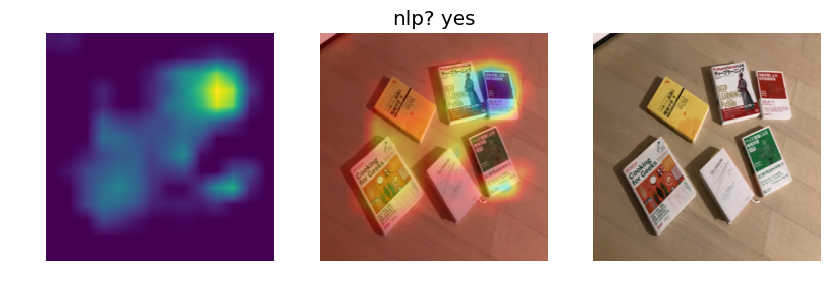

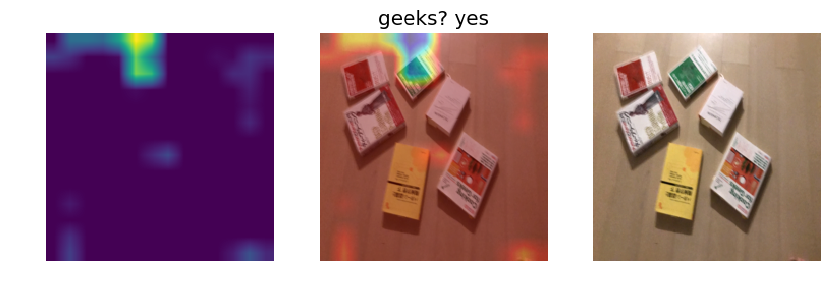

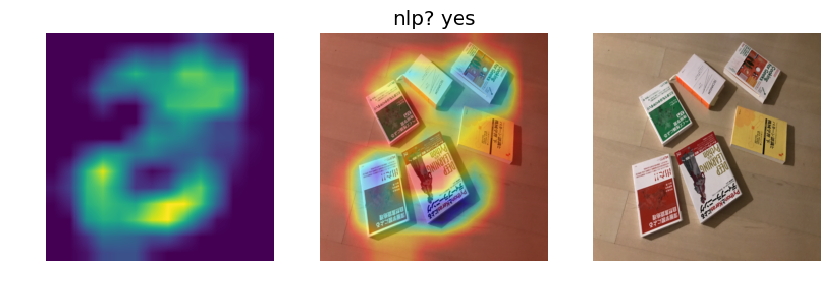

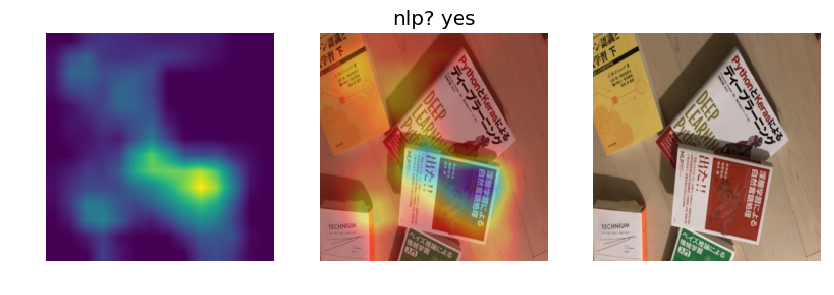

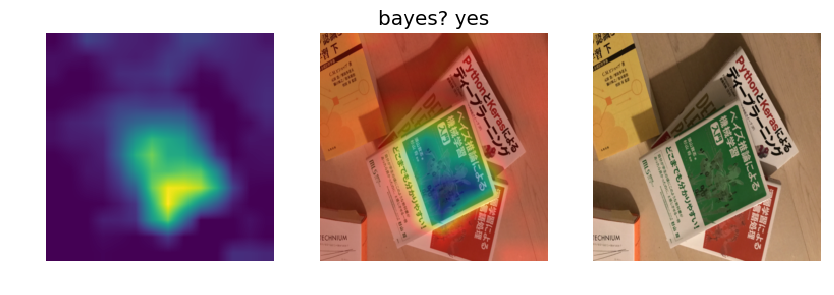

...

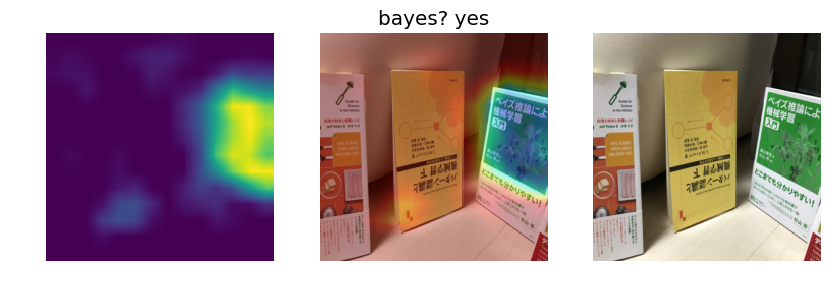

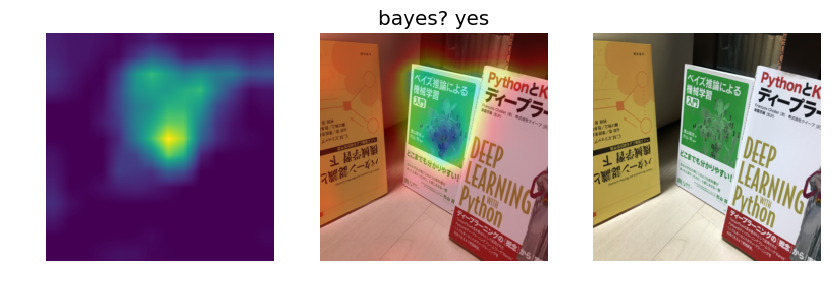

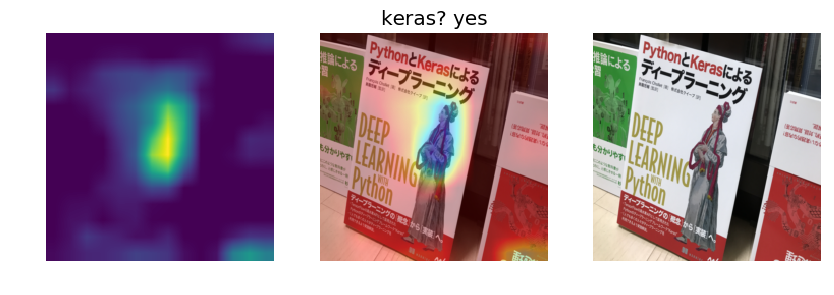

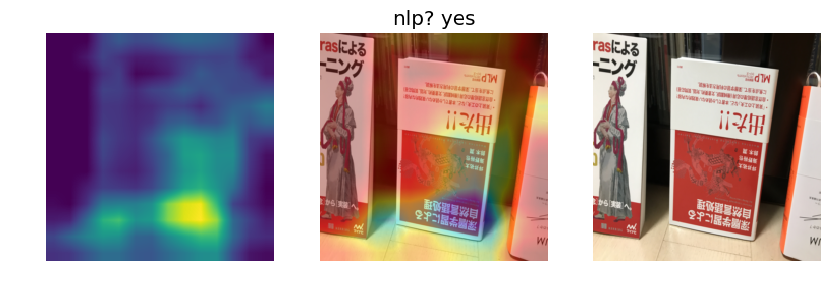

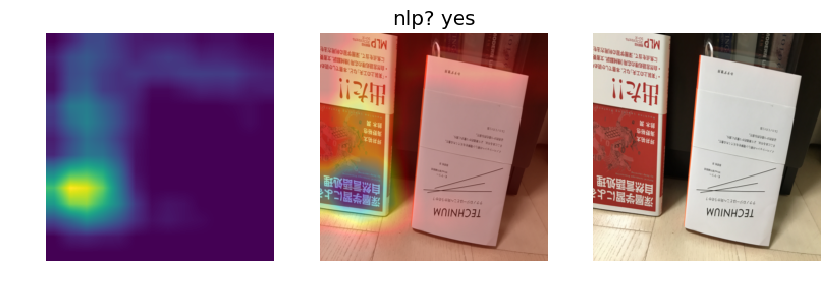

In [37]:
for i in range(20):
    visualize_cam(model, 'model_weights_block4_conv1_imagenet_full_aug.h5', i, datapath / 'test_difficult',
                 test_difficult_expected_preds)

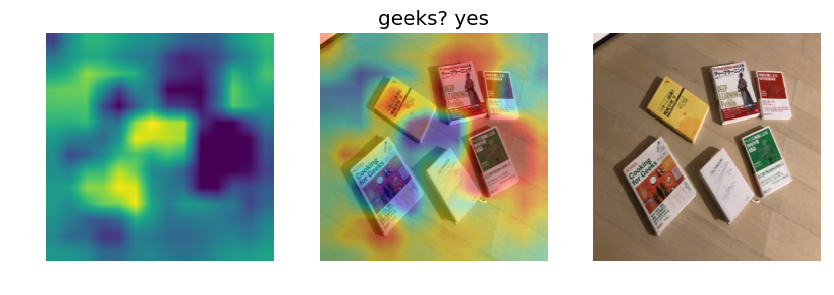

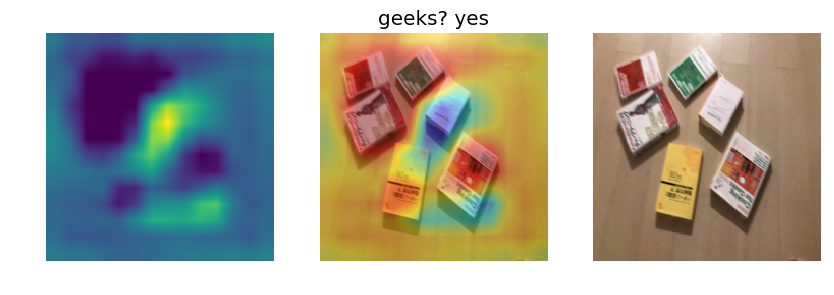

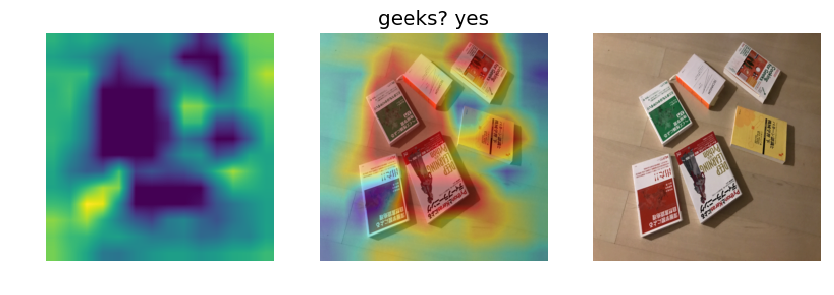

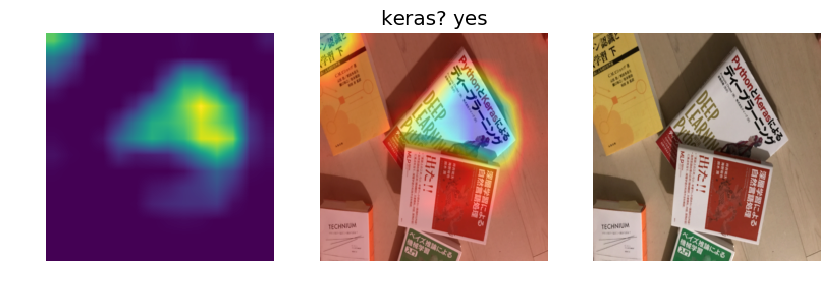

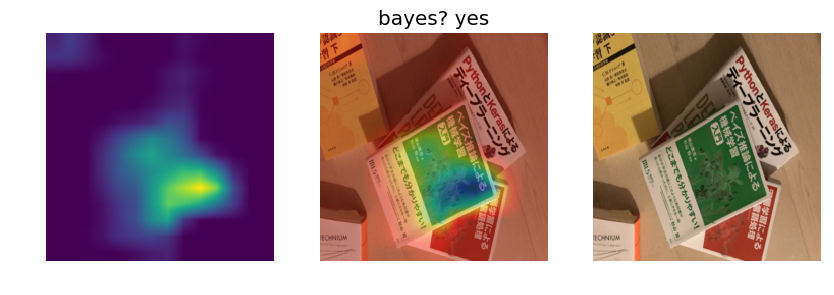

...

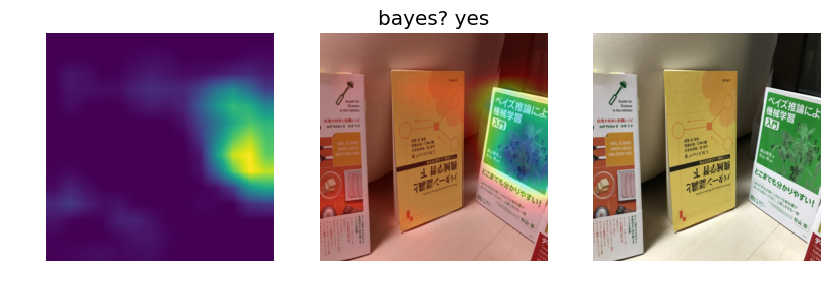

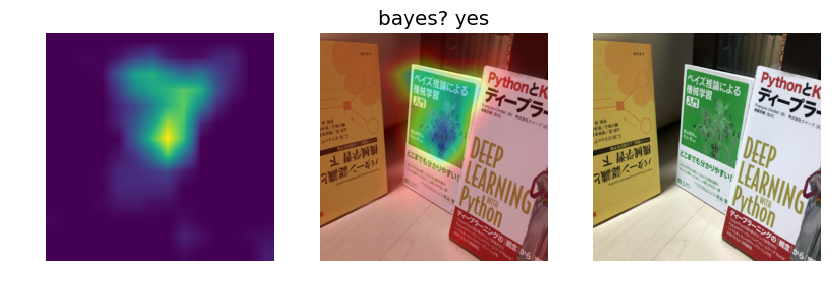

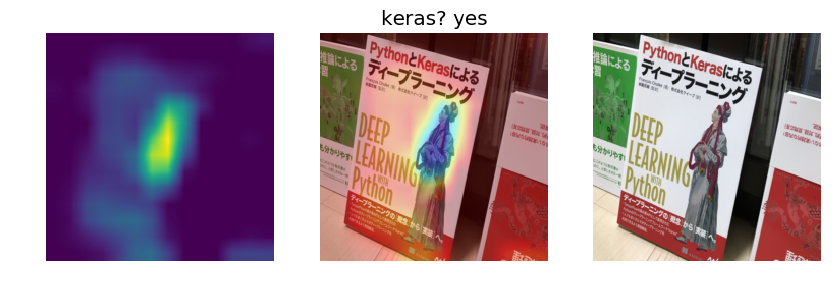

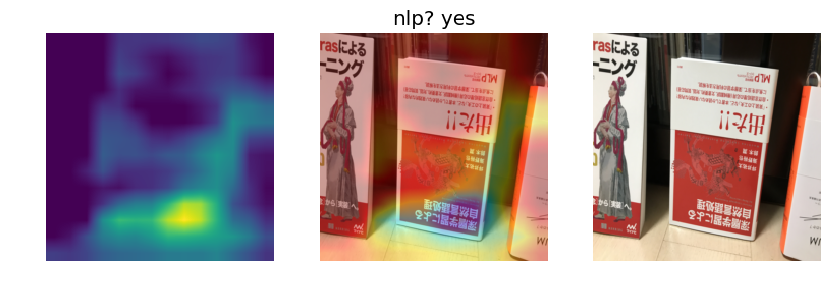

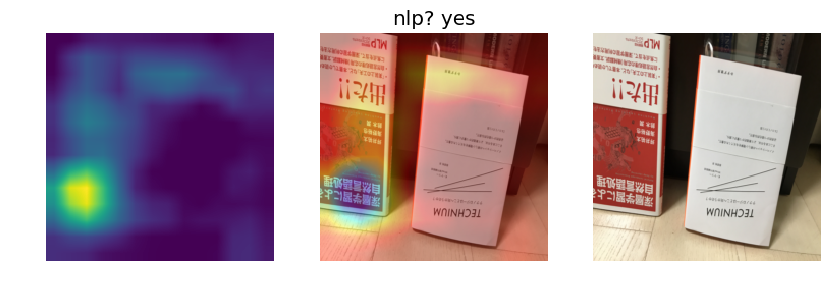

In [38]:
for i in range(20):
    visualize_cam(model, 'model_weights_block4_conv1_imagenet_aug_no_mixup.h5', i, datapath / 'test_difficult',
                  test_difficult_expected_preds)

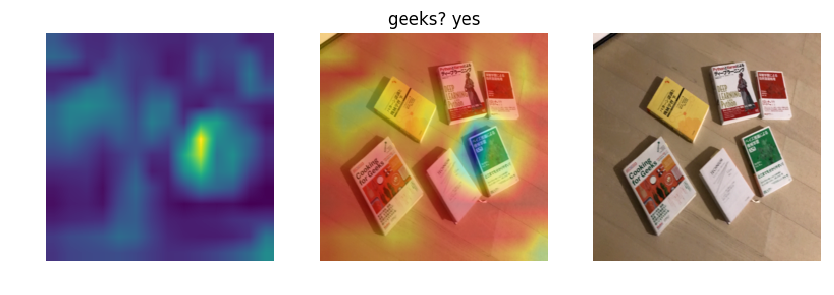

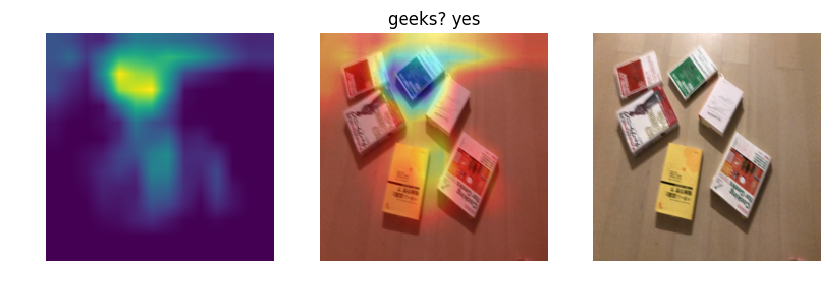

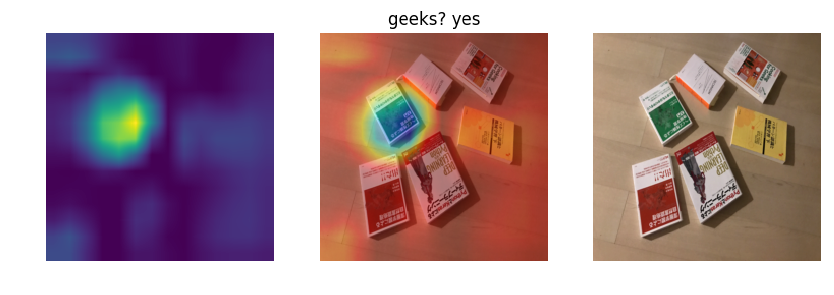

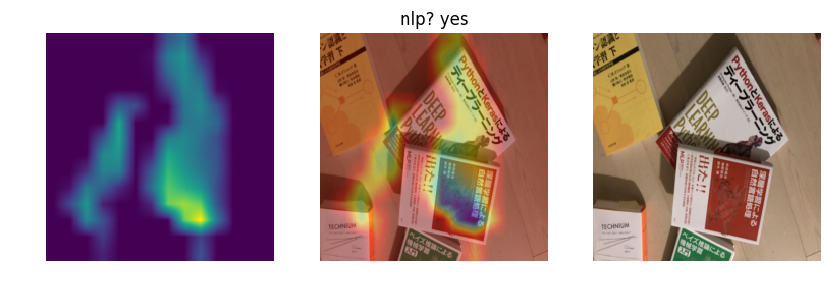

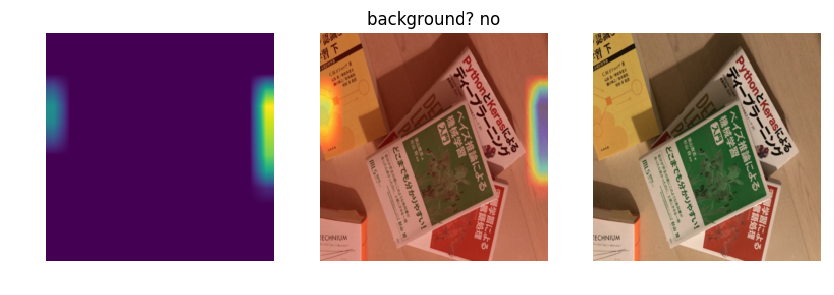

...

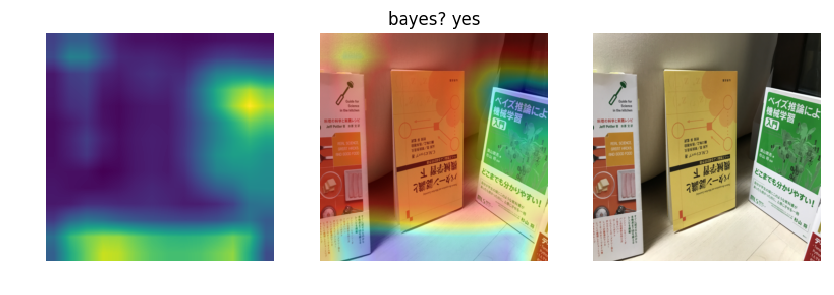

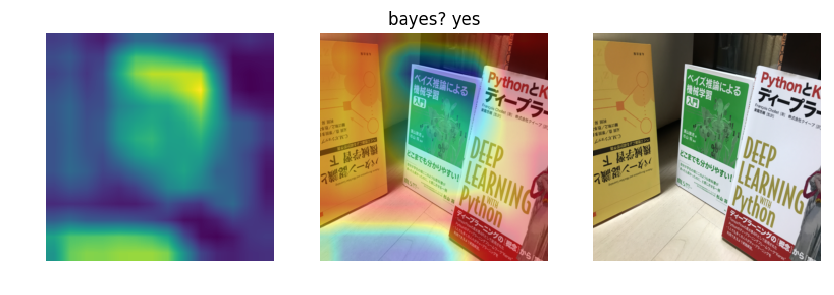

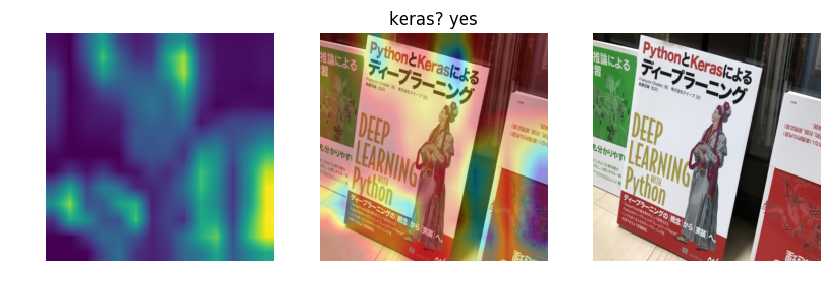

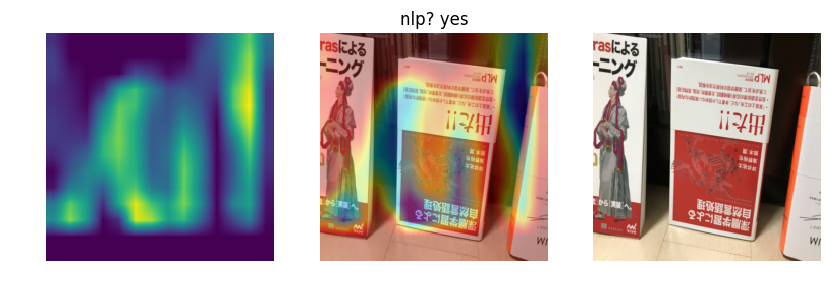

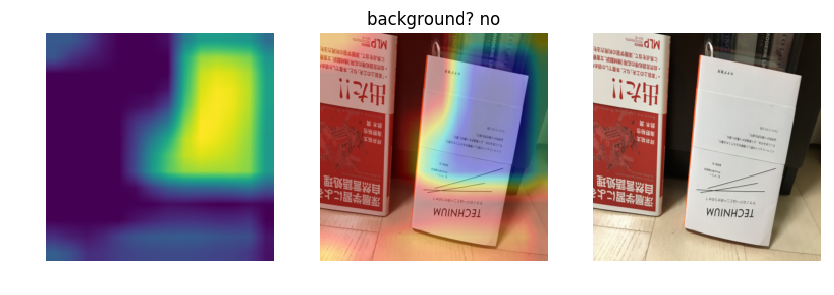

In [9]:
model, base_model = model_imagenet_x(input_shape=conf.shape, num_classes=len(d.labels), weights='imagenet')
for i in range(20):
    visualize_cam(model, 'model_weights_from_scratch_full_aug.h5', i, datapath / 'test_difficult',
                  test_difficult_expected_preds)

accuracy =  0.65


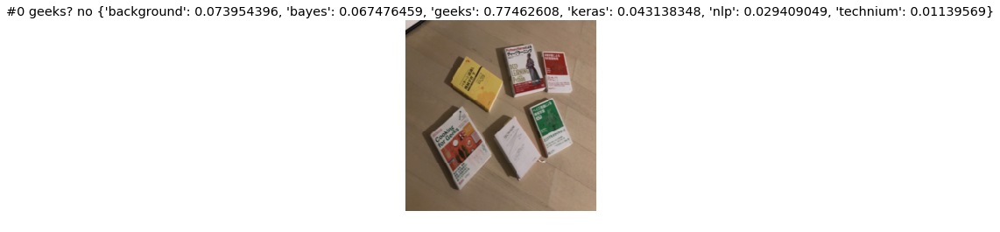

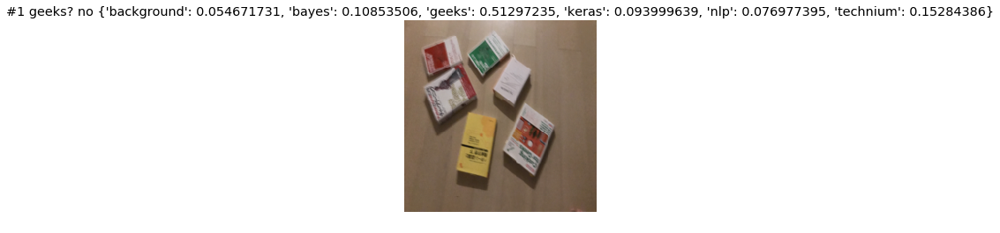

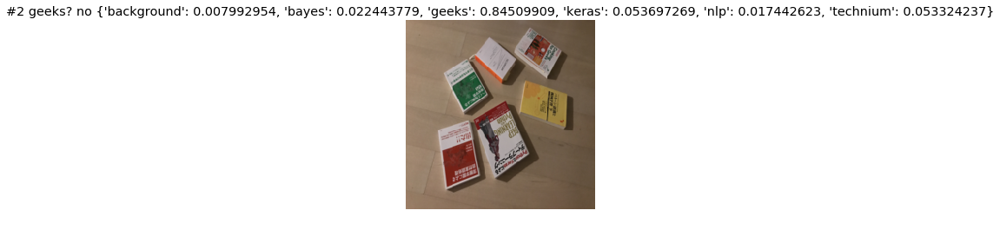

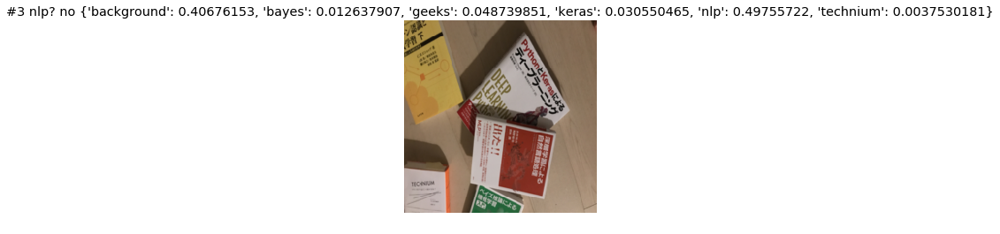

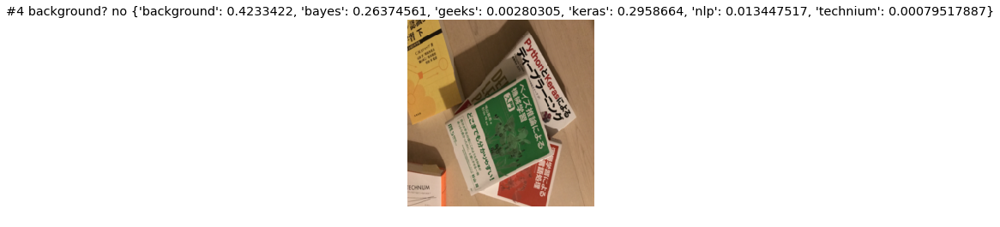

...

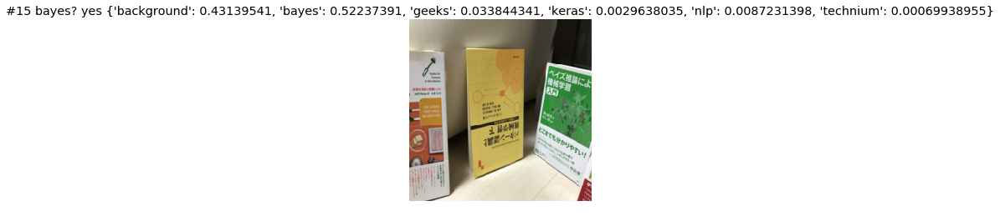

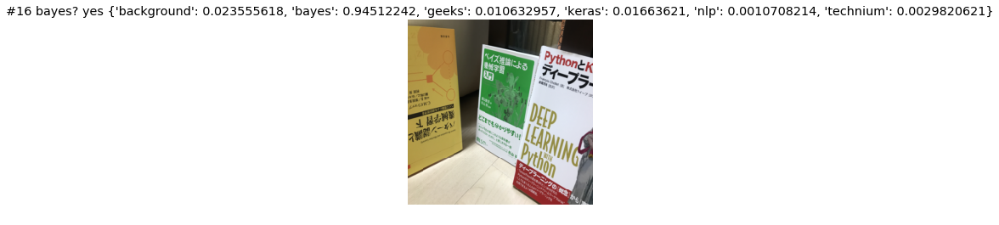

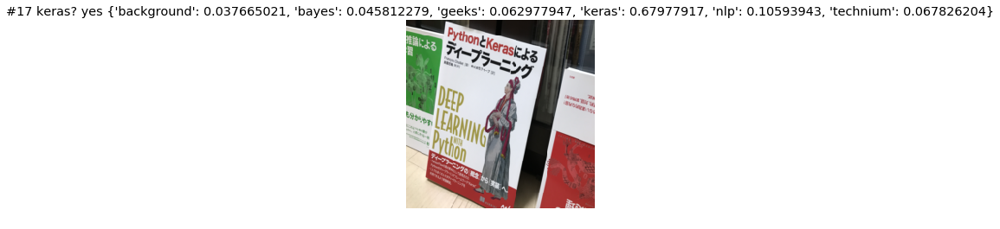

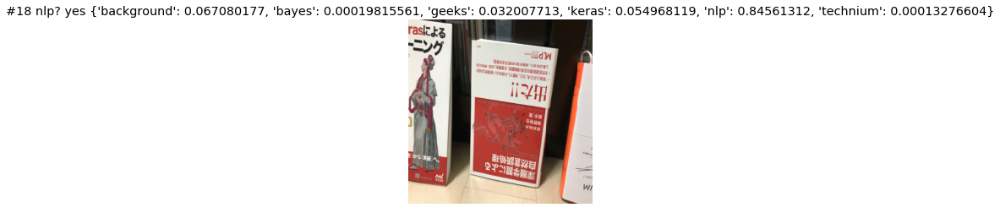

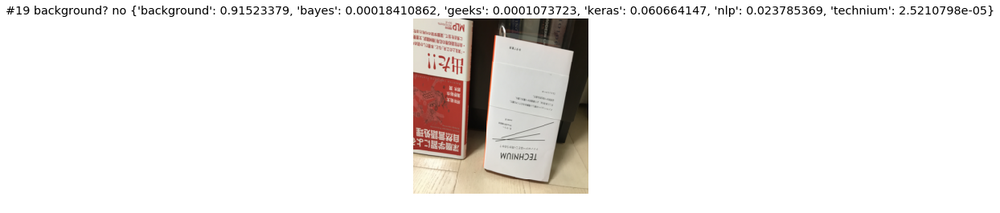

0.65000000000000002

In [6]:
model, base_model = model_imagenet_x(input_shape=conf.shape, num_classes=len(d.labels), weights=None)
evaluate_test(model, 'model_weights_from_scratch_full_aug.h5', datapath / 'test_difficult',
              test_difficult_expected_preds, {})

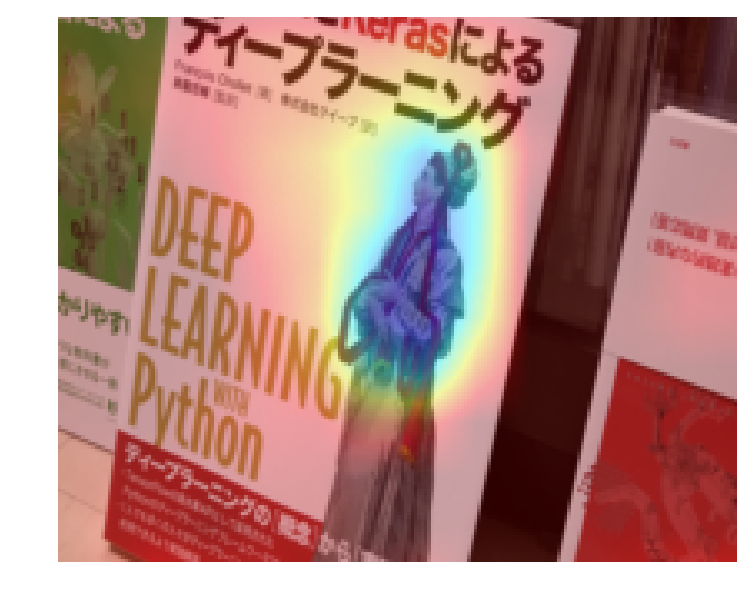

In [19]:
def visualize_cam_big(model, model_weight, test_file_index, datapath, 
                  expected_preds, test_time_aug_param={}, savefile=''):
    d.load_test_as_image(datapath)
    d.create_test_generator(test_time_aug_param)
    model.load_weights(model_weight)
    last_conv_layer = model.get_layer('block5_conv3')
    cur_X_test, cur_y_test = next(d.test_gen)
    x = np.array([cur_X_test[test_file_index]])
    preds = model.predict(x)
    targ_class = np.argmax(preds[0])
    result = calc_soft_acc(expected_preds[test_file_index], preds[0])

    output = model.output[:, targ_class]
    grads = K.gradients(output, last_conv_layer.output)[0]
    pooled_grads = K.mean(grads, axis=(0, 1, 2))
    iterate = K.function([model.input], [pooled_grads, last_conv_layer.output[0]])
    pooled_grads_value, conv_layer_output_value = iterate([x])
    for i in range(int(last_conv_layer.output.shape[3])):
        conv_layer_output_value[:, :, i] *= pooled_grads_value[i]
    heatmap = np.mean(conv_layer_output_value, axis=-1)
    heatmap = np.maximum(heatmap, 0)
    heatmap /= np.max(heatmap)
    
    img = next(d.test_gen)[0][test_file_index]
    fig = plt.figure(figsize=(7, 7), dpi=125)
    heatmap = cv2.resize(heatmap, (img.shape[1], img.shape[0]))
    heatmap = np.uint8(255 * heatmap)
    heatmap = cv2.applyColorMap(heatmap, cv2.COLORMAP_JET)
    superimposed = ((heatmap*0.5/np.max(heatmap) + img)) / 1.5
    superimposed = superimposed[30:-30, 10:-10, :]
    ax = fig.add_subplot(111)
    ax.set_axis_off()
    ax.imshow(imshow_friendly(superimposed))
    #ax.set_title('%s? %s' % (d.labels[targ_class], 'yes' if result == 1 else 'no'), fontsize=12)
    fig.show()
    if savefile != '': fig.savefig(savefile)
for i in [17]:
    visualize_cam_big(model, 'model_weights_block4_conv1_imagenet_full_aug.h5', i, datapath / 'test_difficult',
                 test_difficult_expected_preds, savefile='title.jpg')